In [1]:
import os
import sys
import torch
import torchvision
import numpy as np
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
import torch.nn.functional as F
import torchvision.transforms as T

In [2]:
sys.path.append('../diffusion-models-for-cosmological-fields/annotated/')
import hf_diffusion
import utils
import evaluate

## Nx=64 Model: Run 9-27_14-28
### Worst of the best case runs

In [3]:
#real fields (without augmenting)
fields64 = np.load('../data_processed/LogMaps_Mcdm_IllustrisTNG_LH_z=0.00_Nx64_train.npy')
print(len(fields64))
RANGEMIN, RANGEMAX = np.min(fields64), np.max(fields64)
tr, invtr = hf_diffusion.get_minmax_transform(torch.tensor(RANGEMIN), torch.tensor(RANGEMAX))

9000


In [4]:
NSAMP = 100
seed = 20
rng = np.random.default_rng(seed)
choice_idx = rng.choice(len(fields64), NSAMP*2, replace=False)
real_samps = fields64[choice_idx]

In [5]:
#sdict
sdir = '../diffusion-models-for-cosmological-fields/annotated/results/samples_exps/Run_9-27_14-28/'
gen_samps = np.load(sdir+'samps_ckp60000.npy')

In [6]:
real_samps.shape, gen_samps.shape

((200, 64, 64), (100, 64, 64))

In [7]:
samp_list = [real_samps[:NSAMP], gen_samps]

In [8]:
kvals, powspeclist = evaluate.get_powspec_for_samples(samp_list)

In [9]:
plt.rcParams.update({'font.family':'serif', 'font.size': 19})

In [10]:
import importlib
importlib.reload(evaluate)

<module 'evaluate' from '/n/holylfs05/LABS/finkbeiner_lab/Users/nmudur/project_dirs/CMD_2D/notebooks/../diffusion-models-for-cosmological-fields/annotated/evaluate.py'>

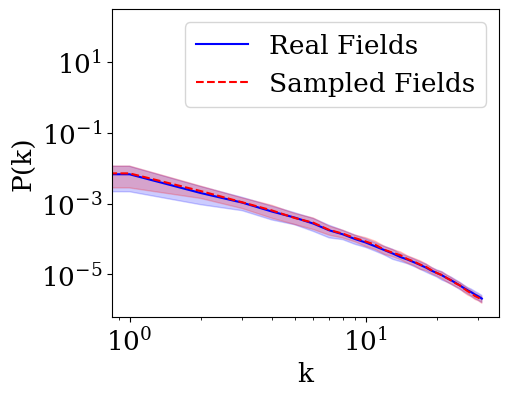

In [11]:
evaluate.plot_ps_samples(kvals, powspeclist, names=['Real Fields', 'Sampled Fields'], 
            savefig_dict={'save_path': 'plots/cosmo_nx64/powspec64_ckp60.png', 'figsize': [5, 4]})

In [12]:
#check
pssamp = powspeclist[0]
print(pssamp.shape)
act = pssamp*(kvals**2)
np.allclose(act[0], np.multiply(pssamp[0], kvals**2))

(100, 32)


True

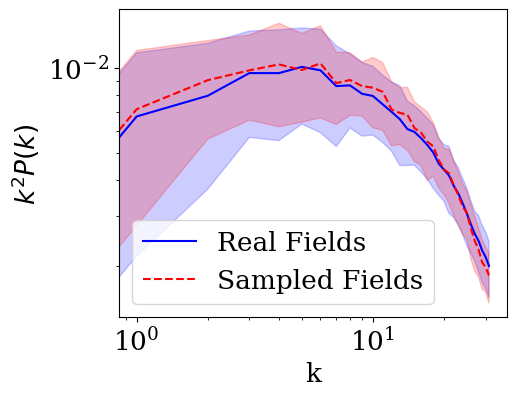

In [13]:
evaluate.plot_ps_samples(kvals, powspeclist, names=['Real Fields', 'Sampled Fields'], k2pk=True, logscale=True,
                        savefig_dict={'save_path': 'plots/cosmo_nx64/k2pk64_ckp60.png', 'figsize': [5, 4]})

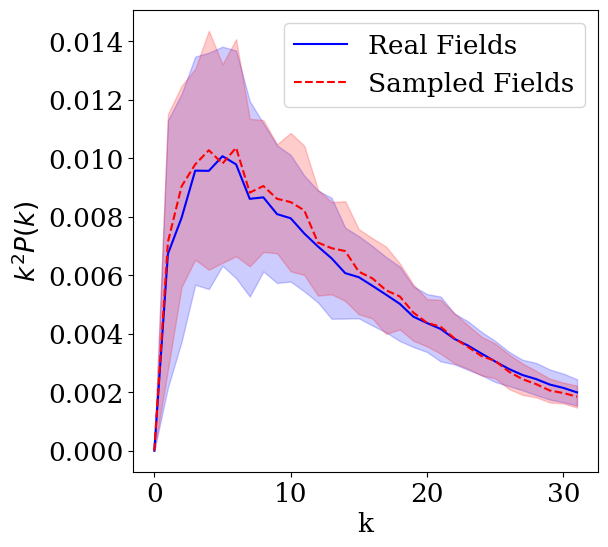

In [15]:
evaluate.plot_ps_samples(kvals, powspeclist, names=['Real Fields', 'Sampled Fields'], k2pk=True, logscale=False)

**Change to meaningful units**

In [16]:
import importlib
importlib.reload(evaluate)

<module 'evaluate' from '/n/holylfs05/LABS/finkbeiner_lab/Users/nmudur/project_dirs/CMD_2D/notebooks/../diffusion-models-for-cosmological-fields/annotated/evaluate.py'>

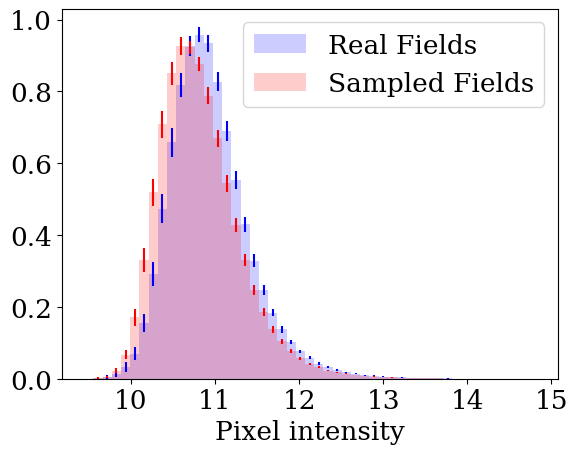

In [17]:
bins = np.linspace(RANGEMIN, RANGEMAX, 50)
sampwise_histmean, sampwise_histstd = evaluate.get_pixel_histogram_for_samples(samp_list,
        {'bins': bins, 'density': True}, names=['Real Fields', 'Sampled Fields'], 
        cols=['b', 'r'], with_err=True, savefig_dict={'save_path': 'plots/cosmo_nx64/pix_hist_ckp60.pdf'})

In [18]:
'r-'.isalnum()

False

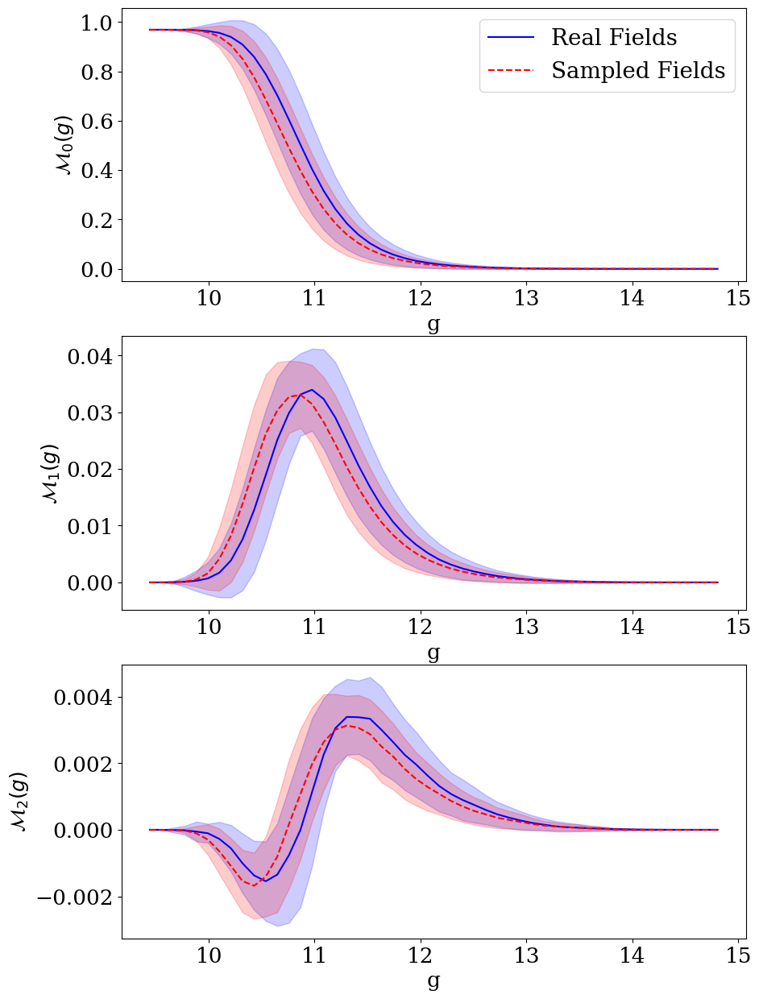

In [19]:
smm, sms = evaluate.plot_mink_functionals(samp_list, 
                      gs_vals = np.linspace(RANGEMIN, RANGEMAX, 50),
                      names = ['Real Fields', 'Sampled Fields'], cols = ['b', 'r'], 
                      savefig_dict={'save_path': 'plots/cosmo_nx64/mink_funcs_ckp60.pdf'})

## Nx=128 Model: Run 9-27_4-19: T=2000

In [3]:
fields128 = np.load('../data_processed/LogMaps_Mcdm_IllustrisTNG_LH_z=0.00_Nx128_shiftaugmentedtrain.npy', mmap_mode='r')
print(len(fields128))
RANGEMIN, RANGEMAX = np.min(fields128), np.max(fields128)
tr, invtr = hf_diffusion.get_minmax_transform(torch.tensor(RANGEMIN), torch.tensor(RANGEMAX))

252000


In [4]:
NSAMP = 100
seed = 20
rng = np.random.default_rng(seed)
choice_idx = rng.choice(10500, NSAMP*2, replace=False)
real_samps = fields128[choice_idx]

In [5]:
sdir = '../diffusion-models-for-cosmological-fields/annotated/results/samples_exps/Run_9-27_4-19/'
gen_samps = np.load(sdir+'samps_ckp46000.npy')

In [6]:
del fields128

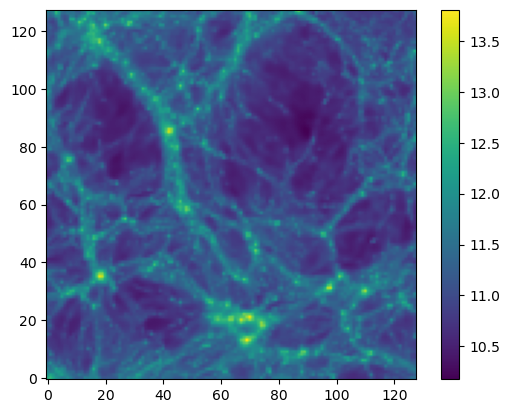

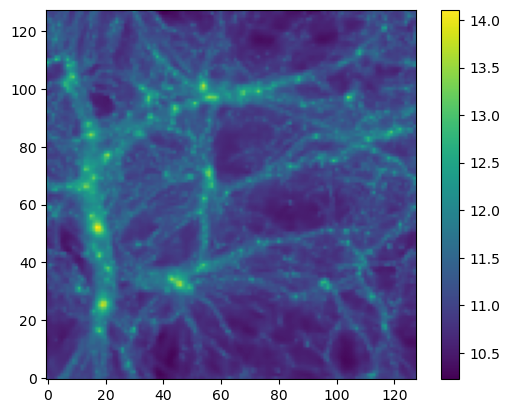

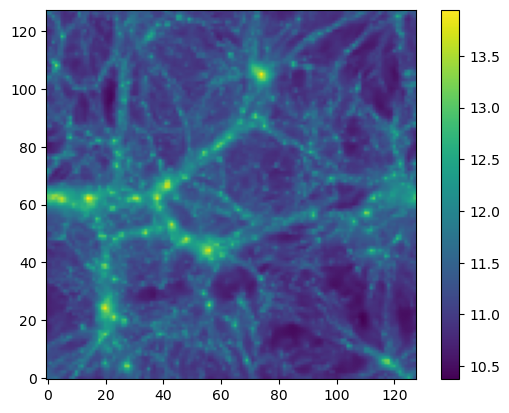

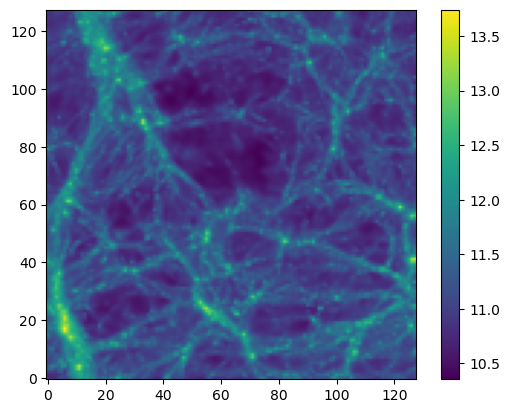

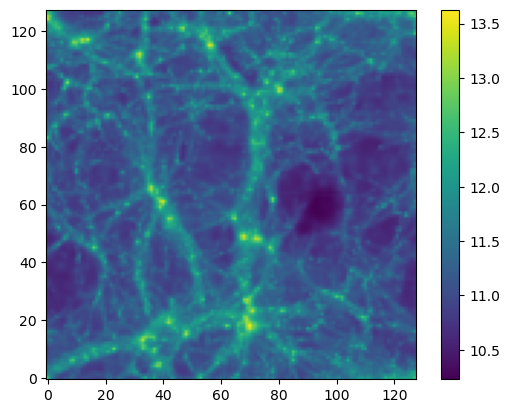

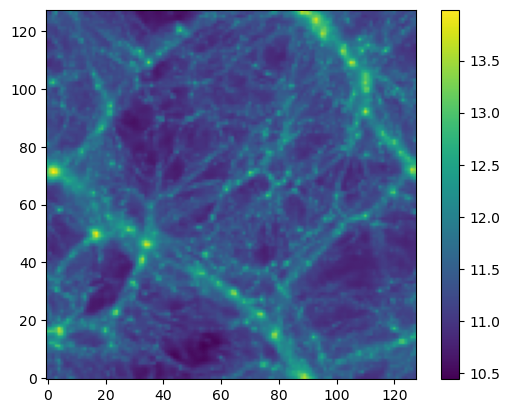

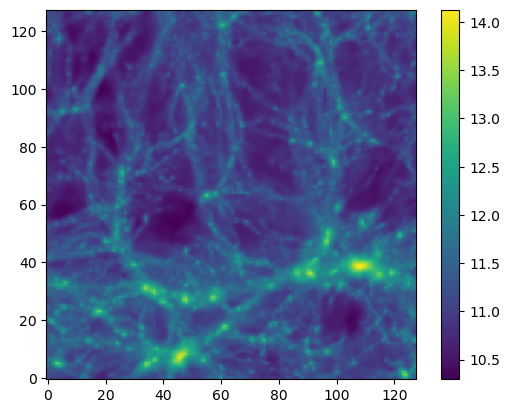

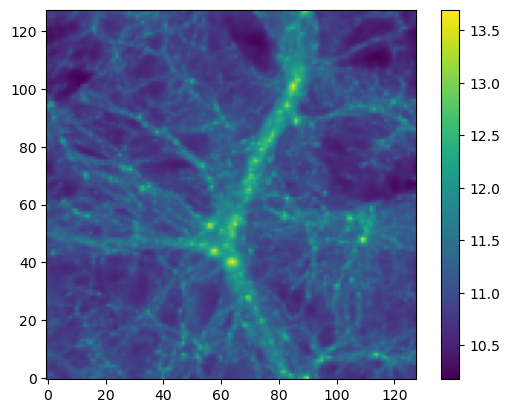

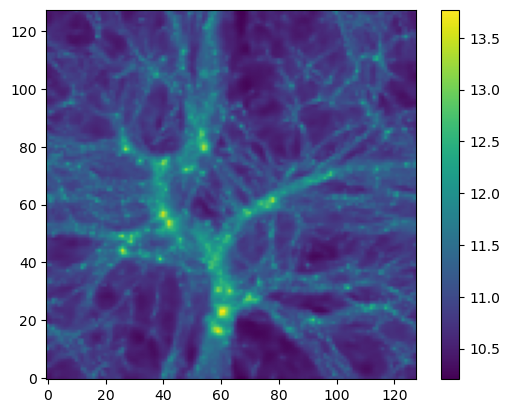

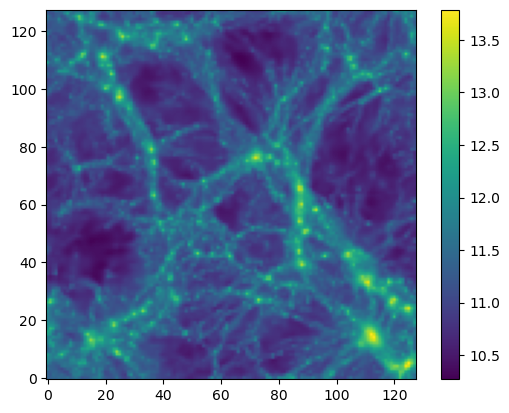

In [7]:
for i in range(90, 100):
    plt.figure()
    c = plt.imshow(gen_samps[i], origin='lower')
    plt.colorbar(c)
    plt.show()

In [8]:
samp_list = [real_samps[:NSAMP], gen_samps]

In [9]:
kvals, powspeclist = evaluate.get_powspec_for_samples(samp_list)

In [10]:
plt.rcParams.update({'font.family':'serif', 'font.size': 19})

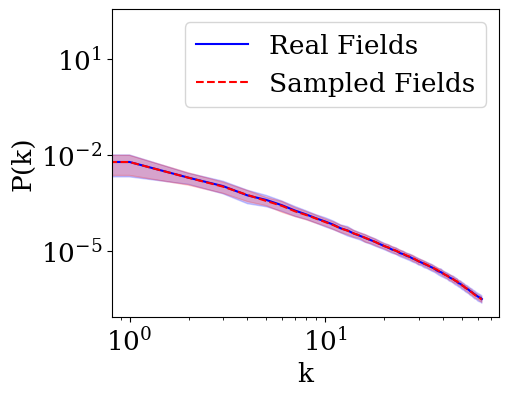

In [11]:
evaluate.plot_ps_samples(kvals, powspeclist, names=['Real Fields', 'Sampled Fields'], 
                         savefig_dict={'save_path': 'plots/cosmo_nx128/powspec128.png', 'figsize': [5, 4]})

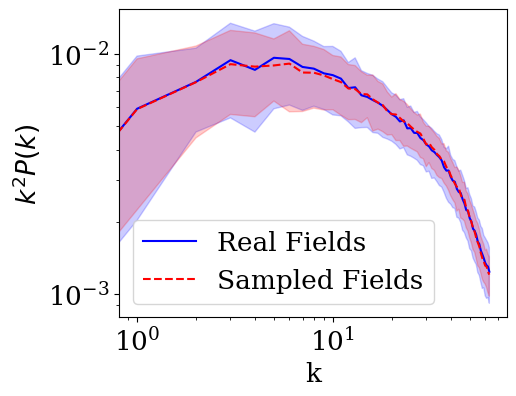

In [13]:
evaluate.plot_ps_samples(kvals, powspeclist, names=['Real Fields', 'Sampled Fields'], k2pk=True, logscale=True,
                        savefig_dict={'save_path': 'plots/cosmo_nx128/k2pk128.png', 'figsize': [5, 4]})

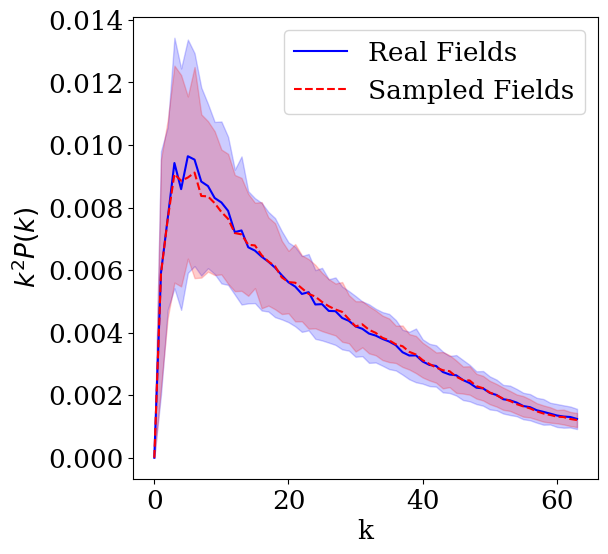

In [14]:
evaluate.plot_ps_samples(kvals, powspeclist, names=['Real Fields', 'Sampled Fields'], k2pk=True, logscale=False)

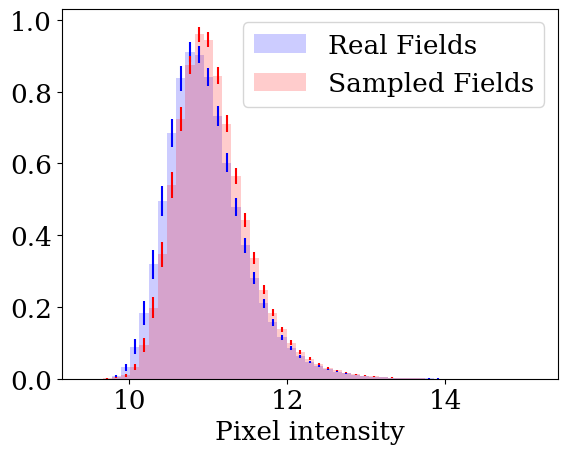

In [15]:
bins = np.linspace(RANGEMIN, RANGEMAX, 50)
sampwise_histmean, sampwise_histstd = evaluate.get_pixel_histogram_for_samples(samp_list,
        {'bins': bins, 'density': True}, names=['Real Fields', 'Sampled Fields'], cols=['b', 'r'], with_err=True,
        savefig_dict={'save_path': 'plots/cosmo_nx128/pix_hist.pdf'})

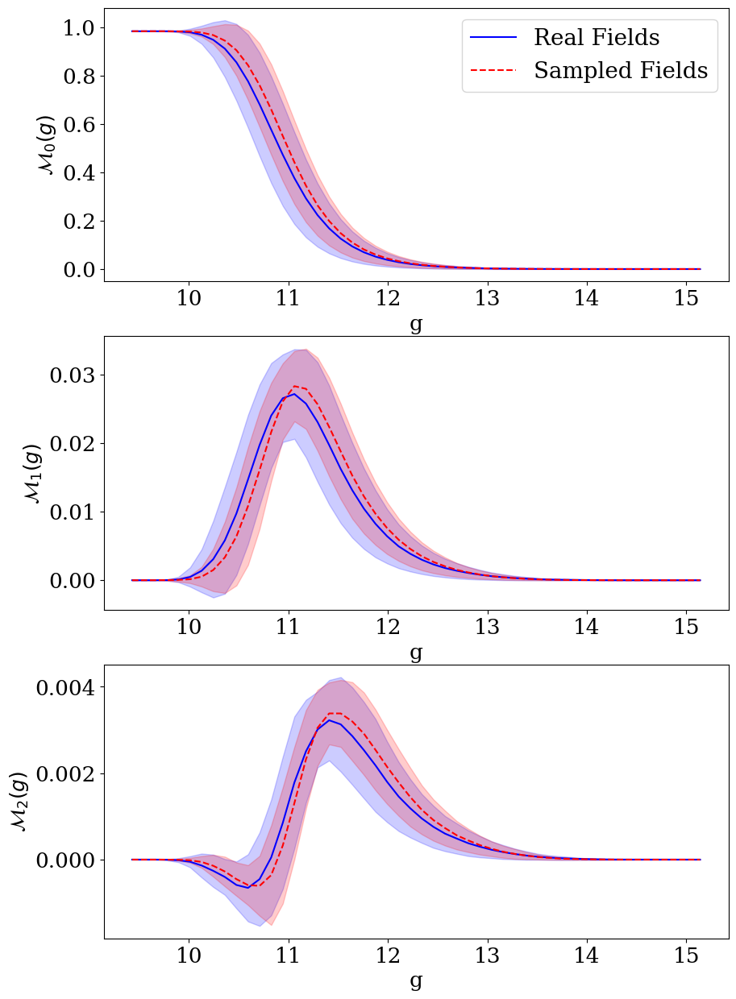

In [16]:
smm, sms = evaluate.plot_mink_functionals(samp_list, 
                gs_vals = np.linspace(RANGEMIN, RANGEMAX, 50),
                names = ['Real Fields', 'Sampled Fields'], cols = ['b', 'r'],
                savefig_dict={'save_path': 'plots/cosmo_nx128/mink_funcs.pdf'})

In [3]:
sdir = '../diffusion-models-for-cosmological-fields/annotated/results/samples_exps/Run_9-16_11-9/'

In [5]:
samp64 = np.load(sdir+'final_samples.npy')

In [20]:
rng = np.random.default_rng(2)
cidx = rng.choice(100, 8, replace=False)

In [11]:
import importlib
importlib.reload(evaluate)

<module 'evaluate' from '/n/holylfs05/LABS/finkbeiner_lab/Users/nmudur/project_dirs/CMD_2D/notebooks/../diffusion-models-for-cosmological-fields/annotated/evaluate.py'>

### Nx=64

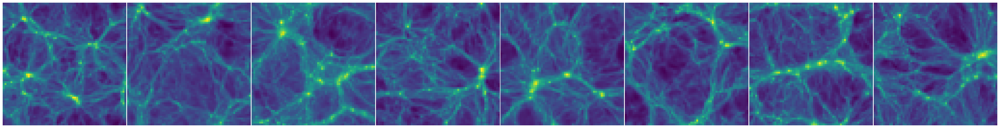

In [22]:
evaluate.plot_panel_images([samp64[idx] for idx in cidx], titles=None, 
            nrow=1, ncol=8, figsize=[48, 6], 
            savefig_dict={'no_colorbar': True, 'wspace': 0,  'save_path': 'plots/cosmo_nx64/samples.pdf'})

In [24]:
fields64 = np.load('../data_processed/LogMaps_Mcdm_IllustrisTNG_LH_z=0.00_Nx64_train.npy')

In [25]:
cidx= rng.choice(len(fields64), 8, replace=False)

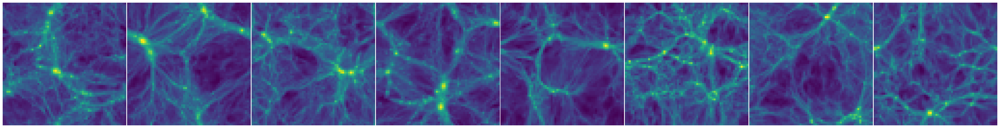

In [26]:
evaluate.plot_panel_images([fields64[idx] for idx in cidx], titles=None, 
            nrow=1, ncol=8, figsize=[48, 6], 
            savefig_dict={'no_colorbar': True, 'wspace': 0, 'save_path': 'plots/cosmo_nx64/true_train.pdf'})

### Nx=128

In [4]:
sdir = '../diffusion-models-for-cosmological-fields/annotated/results/samples_exps/Run_9-27_4-19/'
samps128 = np.load(sdir+'samps_ckp46000.npy')

In [5]:
rng = np.random.default_rng(12)
cidx = rng.choice(100, 8, replace=False)

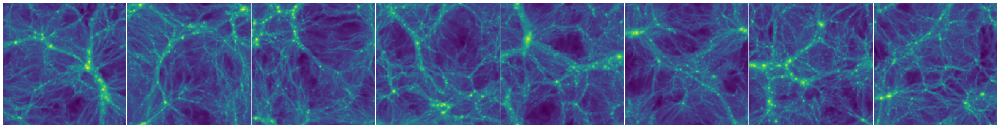

In [6]:
evaluate.plot_panel_images([samps128[idx] for idx in cidx], titles=None, 
            nrow=1, ncol=8, figsize=[48, 6], 
            savefig_dict={'no_colorbar': True, 'wspace': 0,  'save_path': 'plots/cosmo_nx128/samples.pdf'})

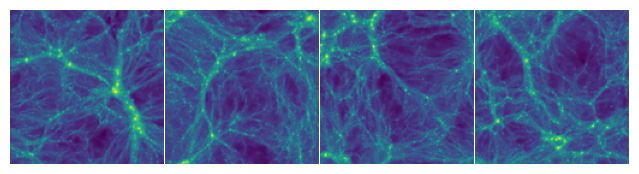

In [22]:
evaluate.plot_panel_images([samps128[idx] for idx in cidx[:4]], titles=None, 
            nrow=1, ncol=4, figsize=[8, 2], 
            savefig_dict={'no_colorbar': True, 'wspace': 0, 'save_path': 'plots/cosmo_nx128/samples4.pdf'})

In [7]:
fields128 = np.load('../data_processed/LogMaps_Mcdm_IllustrisTNG_LH_z=0.00_Nx128_shiftaugmentedtrain.npy', mmap_mode='r')
choice_idx = rng.choice(10500, 8, replace=False)

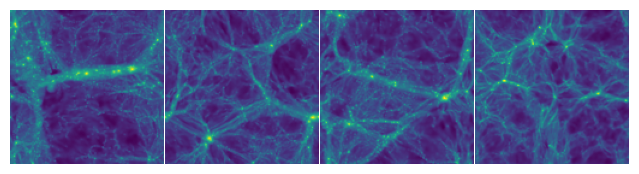

In [23]:
evaluate.plot_panel_images([fields128[idx] for idx in choice_idx[:4]], titles=None, 
            nrow=1, ncol=4, figsize=[8, 2], 
            savefig_dict={'no_colorbar': True, 'wspace': 0, 'save_path': 'plots/cosmo_nx128/true_train4.pdf'})

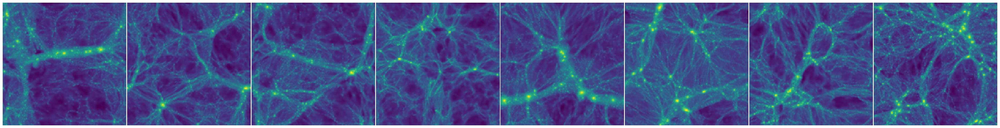

In [8]:
evaluate.plot_panel_images([fields128[idx] for idx in choice_idx], titles=None, 
            nrow=1, ncol=8, figsize=[48, 6], 
            savefig_dict={'no_colorbar': True, 'wspace': 0, 'save_path': 'plots/cosmo_nx128/true_train.pdf'})

### Dust

In [24]:
from astropy.io import fits

In [25]:
dust_path = '../data_processed/dust/dust_train.fits'
with fits.open(dust_path) as hdul:
    data = hdul[0].data
rng = np.random.default_rng(24)
choice_idx = rng.choice(len(data), 8, replace=False)
dusttrue = data[choice_idx,...]

In [26]:
len(data)

8506

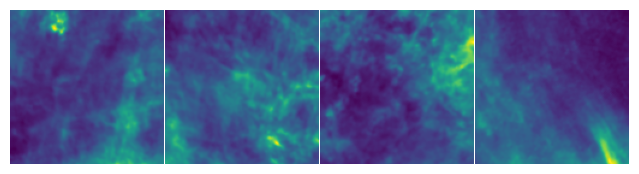

In [27]:
evaluate.plot_panel_images([dusttrue[idx].astype(np.float32) for idx in range(len(choice_idx))[:4]], titles=None, 
            nrow=1, ncol=4, figsize=[8, 2], 
            savefig_dict={'no_colorbar': True, 'wspace': 0, 'save_path': 'plots/dust/true_train_scaled4.pdf'})

In [28]:
sdir = '../diffusion-models-for-cosmological-fields/annotated/results/samples_exps/Run_9-26_11-22/'
samps128 = np.load(sdir+'samps_ckp42000.npy')

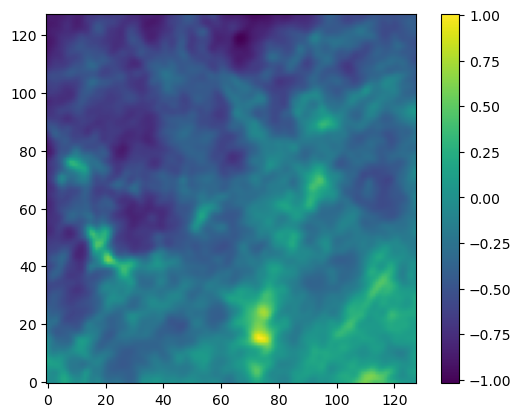

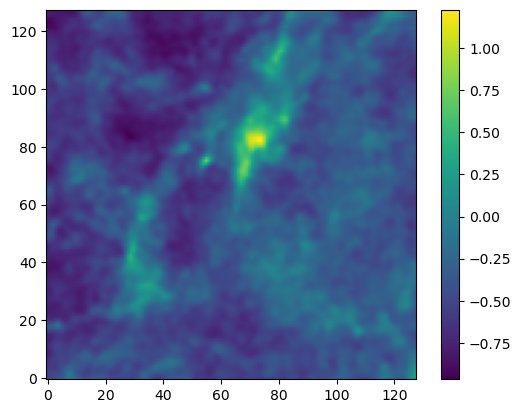

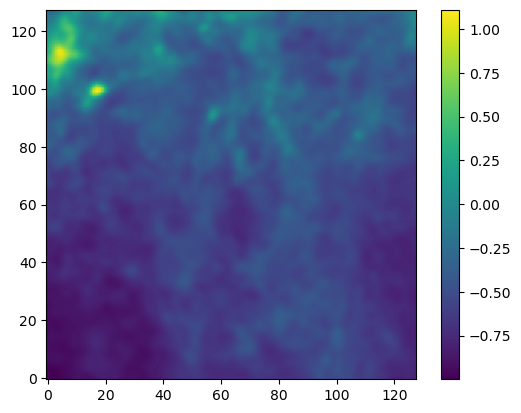

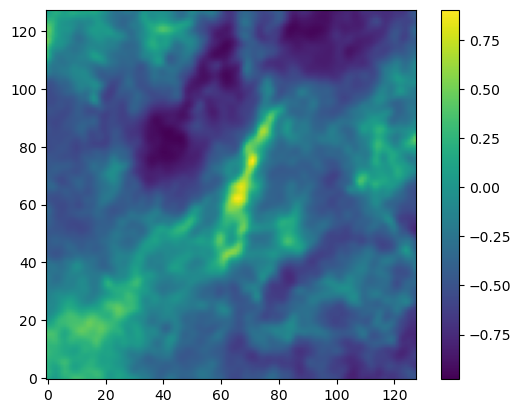

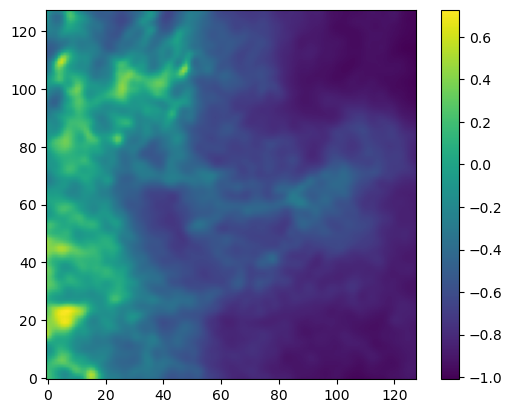

...

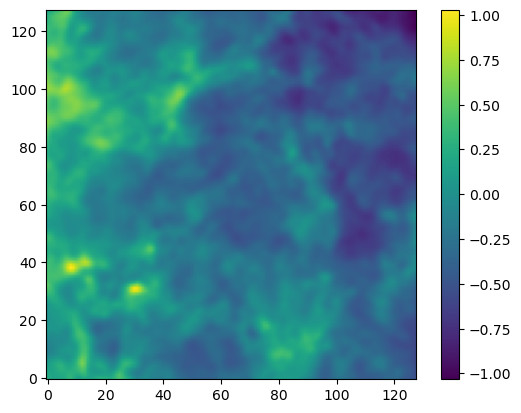

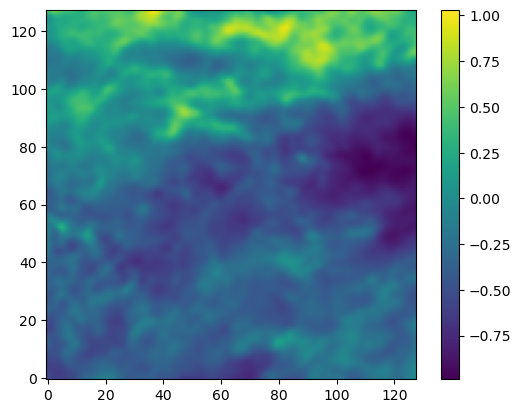

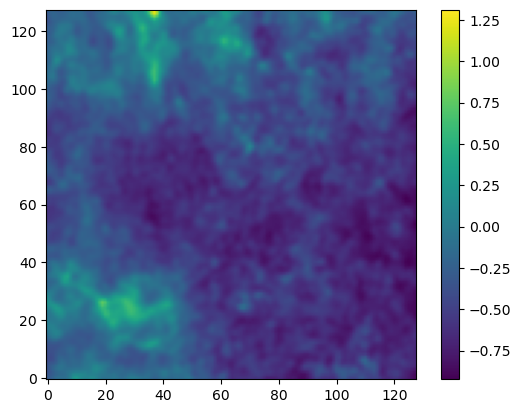

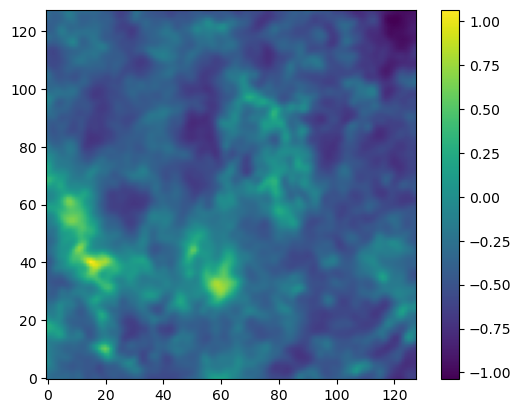

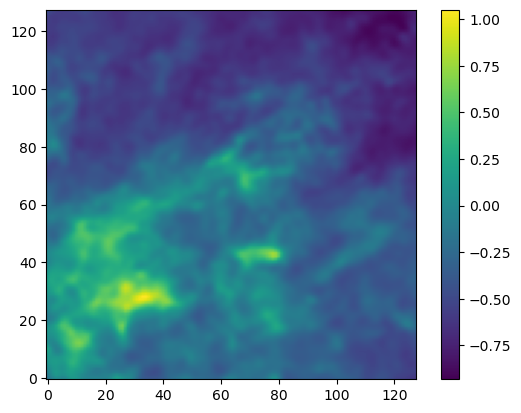

In [9]:
for i in range(0,100):
    plt.figure()
    c = plt.imshow(samps128[i, ...], origin='lower')
    plt.colorbar(c)
    plt.show()

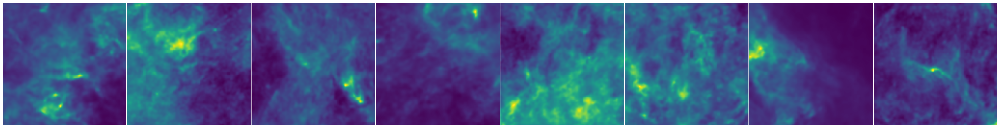

In [10]:
choice_idx = rng.choice(100, 8, replace=False)
evaluate.plot_panel_images([samps128[idx].astype(np.float32) for idx in choice_idx], titles=None, 
            nrow=1, ncol=8, figsize=[48, 6], 
            savefig_dict={'no_colorbar': True, 'wspace': 0, 'save_path': 'plots/dust/samples.pdf'})

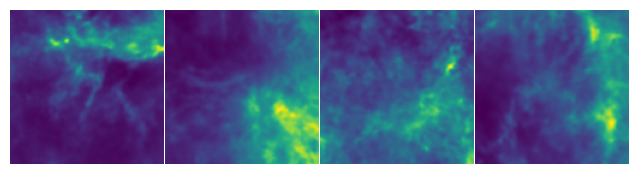

In [31]:
choice_idx = rng.choice(100, 4, replace=False)
evaluate.plot_panel_images([samps128[idx].astype(np.float32) for idx in choice_idx], titles=None, 
            nrow=1, ncol=4, figsize=[8, 2], 
            savefig_dict={'no_colorbar': True, 'wspace': 0, 'save_path': 'plots/dust/samples4.pdf'})

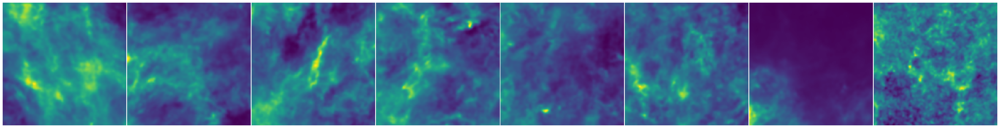

In [30]:
choice_idx = rng.choice(100, 8, replace=False)
evaluate.plot_panel_images([samps128[idx].astype(np.float32) for idx in choice_idx], titles=None, 
            nrow=1, ncol=8, figsize=[48, 6], 
            savefig_dict={'no_colorbar': True, 'wspace': 0, 'save_path': 'plots/dust/samplesre.pdf'})